<a href="https://colab.research.google.com/github/Anohita2004/Anohita2004/blob/main/Copy_of_Fake_News_Classifier__using_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
anohitamukherjee_train_tsv_path = kagglehub.dataset_download('anohitamukherjee/train-tsv')

print('Data source import complete.')


100%|██████████| 29.3M/29.3M [00:02<00:00, 12.0MB/s]

Extracting files...


Data source import complete.


In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [ ]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import re
from wordcloud import WordCloud

In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Embedding, LSTM, Conv1D, MaxPool1D
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score

In [ ]:
import pandas as pd

# Replace 'file.tsv' with the path to your TSV file
file_path = '/content/train.tsv'

# Read the TSV file into a DataFrame
fake = pd.read_csv(file_path, delimiter='\t')

# Display the first few rows of the DataFrame
fake.head()

,Unnamed: 0,title,text,subject,date,label
0,2619,Ex-CIA head says Trump remarks on Russia inter...,Former CIA director John Brennan on Friday cri...,politicsNews,"July 22, 2017",1.0
1,16043,YOU WON’T BELIEVE HIS PUNISHMENT! HISPANIC STO...,How did this man come to OWN this store? There...,Government News,"Jun 19, 2017",0.0
2,876,Federal Reserve governor Powell's policy views...,President Donald Trump on Thursday tapped Fede...,politicsNews,"November 2, 2017",1.0
3,19963,SCOUNDREL HILLARY SUPPORTER STARTS “TrumpLeaks...,Hillary Clinton ally David Brock is offering t...,left-news,"Sep 17, 2016",0.0
4,10783,NANCY PELOSI ARROGANTLY DISMISSES Questions on...,Pleading ignorance is a perfect ploy for Nancy...,politics,"May 26, 2017",0.0


In [ ]:
fake.columns

Index(['Unnamed: 0', 'title', 'text', 'subject', 'date', 'label'], dtype='object')

In [ ]:
fake.drop('Unnamed: 0', axis=1, inplace=True)

In [ ]:
fake.head()

,title,text,subject,date,label
0,Ex-CIA head says Trump remarks on Russia inter...,Former CIA director John Brennan on Friday cri...,politicsNews,"July 22, 2017",1.0
1,YOU WON’T BELIEVE HIS PUNISHMENT! HISPANIC STO...,How did this man come to OWN this store? There...,Government News,"Jun 19, 2017",0.0
2,Federal Reserve governor Powell's policy views...,President Donald Trump on Thursday tapped Fede...,politicsNews,"November 2, 2017",1.0
3,SCOUNDREL HILLARY SUPPORTER STARTS “TrumpLeaks...,Hillary Clinton ally David Brock is offering t...,left-news,"Sep 17, 2016",0.0
4,NANCY PELOSI ARROGANTLY DISMISSES Questions on...,Pleading ignorance is a perfect ploy for Nancy...,politics,"May 26, 2017",0.0


##DATA EXPLORATION

In [ ]:
fake.head()
fake.info()
fake.describe()
fake.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1205 entries, 0 to 1204
Data columns (total 5 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   title    1205 non-null   object 
 1   text     1205 non-null   object 
 2   subject  1204 non-null   object 
 3   date     1204 non-null   object 
 4   label    1204 non-null   float64
dtypes: float64(1), object(4)
memory usage: 47.2+ KB


,0
title,0
text,0
subject,1
date,1
label,1


In [ ]:
import re

def clean_text(text):
    text = re.sub(r'[^a-zA-Z\s]', '', text)  # Remove special characters and numbers
    text = text.lower()  # Convert to lowercase
    return text

fake['Cleaned_Text'] = fake['text'].apply(clean_text)  # Assuming 'Text' is the column with news articles

politicsNews:	323
worldnews:	266
News:	231
politics:	167
left-news:	132
Government News:	35
Middle-east:	29
US_News:	21
Total Records:	1205


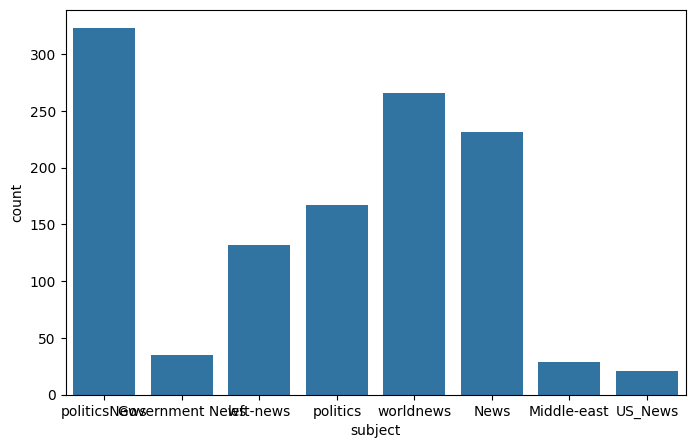

In [ ]:
for key, count in fake.subject.value_counts().items():
    print(f"{key}:\t{count}")
print(f"Total Records:\t{fake.shape[0]}")

plt.figure(figsize=(8, 5))
sns.countplot(x="subject", data=fake)
plt.show()

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


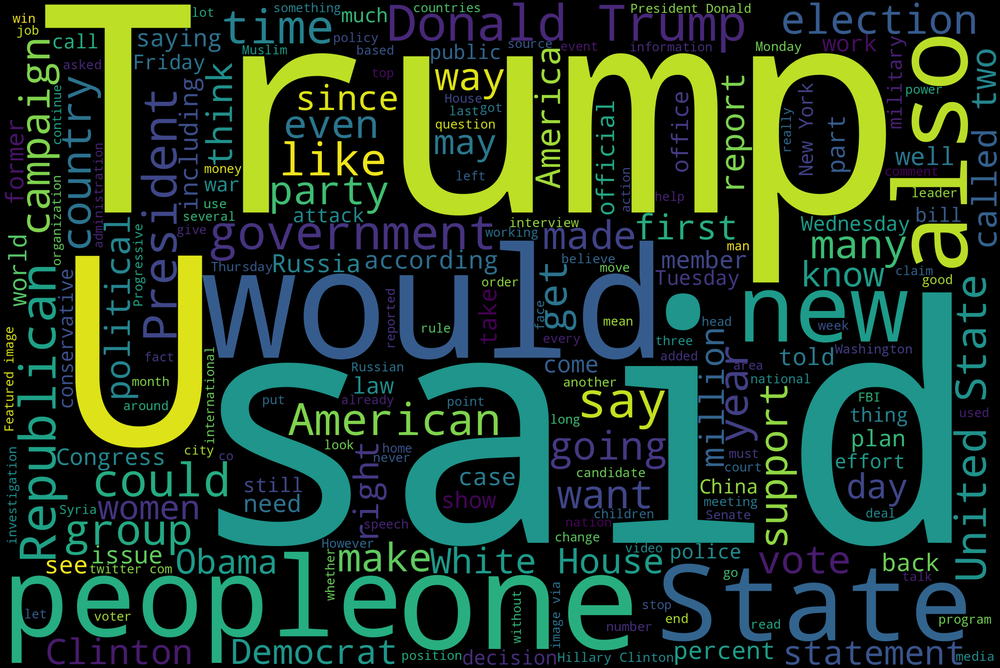

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
nltk.download('stopwords')
import nltk

text = ''
for news in fake.text.values:
    text += f" {news}"
wordcloud = WordCloud(
    width=3000,
    height=2000,
    background_color='black',
    stopwords=set(nltk.corpus.stopwords.words("english"))
).generate(text)

fig = plt.figure(figsize=(40, 30), facecolor='k', edgecolor='k')
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()
del text

PRE PROCESSING DATA

In [ ]:
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords

lemmatizer = WordNetLemmatizer()
stpwrds = list(stopwords.words('english'))

In [ ]:
stpwrds

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [ ]:
nltk.download('punkt_tab')
nltk.download('wordnet')
#lemmatization
for x in range(len(fake)) :
    corpus = []
    review = fake['text'][x]
    review = re.sub(r'[^a-zA-Z\s]', '', review)
    review = review.lower()
    review = nltk.word_tokenize(review)
    for y in review :
        if y not in stpwrds :
            corpus.append(lemmatizer.lemmatize(y))
    review = ' '.join(corpus)
    fake['text'][x] = review

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


USING PASSIVE AGGRESSIVE CLASSIFIER ONLY:

In [ ]:
#splitting the dataset to training and test dataset,80% data to be training data &20% will be testing data.(ie test_size=0.2)
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(fake['text'], fake['label'], test_size=0.2, random_state=0)

In [ ]:
# Remove duplicates from the training data
X_train = X_train.drop_duplicates().reset_index(drop=True)
Y_train = Y_train.iloc[X_train.index].reset_index(drop=True)

In [ ]:
X_train = X_train.drop_duplicates().reset_index(drop=True)
Y_train = Y_train[X_train.index].reset_index(drop=True)  # Align labels with updated X_train index

In [ ]:
# Initialize the vectorizer
vectorizer = TfidfVectorizer(ngram_range=(1, 2))

# Fit the vectorizer on the cleaned training data and transform it
tfidf_X_train = vectorizer.fit_transform(X_train)

# Transform the test data using the same vectorizer
tfidf_X_test = vectorizer.transform(X_test)

# Check the shapes of the transformed data
print("Training data shape:", tfidf_X_train.shape)  # Should be (num_samples_train, num_features)
print("Test data shape:", tfidf_X_test.shape)        # Should be (num_samples_test, num_features)

# Initialize the classifier
classifier = PassiveAggressiveClassifier()

# Fit the model
classifier.fit(tfidf_X_train, Y_train)

# Make predictions
Y_pred = classifier.predict(tfidf_X_test)

# Calculate accuracy
score = metrics.accuracy_score(Y_test, Y_pred)
print(f'Accuracy: {round(score * 100, 2)}%')

# Confusion matrix
cm = metrics.confusion_matrix(Y_test, Y_pred)
print(cm)

Training data shape: (958, 215112)
Test data shape: (241, 215112)
Accuracy: 55.19%
[[77 55]
 [53 56]]


In [ ]:
from sklearn.model_selection import GridSearchCV

param_grid = {
       'C': [0.1, 1, 10],
       'max_iter': [500, 1000, 1500],
       'loss': ['hinge', 'squared_hinge']
   }

grid_search = GridSearchCV(classifier, param_grid, cv=5, scoring='accuracy')
grid_search.fit(tfidf_X_train, Y_train)

print("Best parameters:", grid_search.best_params_)
classifier = grid_search.best_estimator_

Best parameters: {'C': 10, 'loss': 'squared_hinge', 'max_iter': 1500}


USING VOTING ENSEMBLE USING PASSIVEAGGRESSIVE CLASSIFIER,LOGISTIC REGRESSION AND NAIVE BAYES :

In [8]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import PassiveAggressiveClassifier, LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import accuracy_score, classification_report

# 1. Load Your Datasets
file_path1='/content/train.tsv'
file_path2='/content/test.tsv'
train_df =pd.read_csv(file_path1, delimiter='\t') # Replace with your training data file
test_df =pd.read_csv(file_path2, delimiter='\t')    # Replace with your test data file

# 2. Data Preparation
X_train = train_df['text']
y_train = train_df['label']
X_test = test_df['text']

# 3. Feature Extraction (TF-IDF)
# Fit the vectorizer ONLY on the training data
vectorizer = TfidfVectorizer(ngram_range=(1, 2))
X_train_tfidf = vectorizer.fit_transform(X_train)
# Transform the test data using the fitted vectorizer
X_test_tfidf = vectorizer.transform(X_test)

# 4. Define and Train the Voting Classifier
pac = PassiveAggressiveClassifier(max_iter=1000, random_state=42)
lr = LogisticRegression(max_iter=1000, random_state=42)
nb = MultinomialNB()
voting_classifier = VotingClassifier(
    estimators=[('pac', pac), ('lr', lr), ('nb', nb)],
    voting='hard'
)

# Before fitting, remove rows with missing labels and align X_train
y_train = y_train.dropna()
X_train_tfidf = X_train_tfidf[y_train.index]

# Now fit the VotingClassifier with the aligned data
voting_classifier.fit(X_train_tfidf, y_train)

# 5. Make Predictions on the Test Dataset
test_predictions = voting_classifier.predict(X_test_tfidf)

# 6. (Optional) If you have ground truth labels for the test data, evaluate:
if 'label' in test_df:
  y_test = test_df['label']
  accuracy = accuracy_score(y_test, test_predictions)
  print(f"Accuracy: {accuracy:.4f}")
  print(classification_report(y_test, test_predictions))

#7. Save or Use Predictions
# You now have predictions for your test dataset in 'test_predictions'.
# You can save them to a file or use them for further analysis.
#For example, to save to a CSV:
pd.DataFrame({'predictions': test_predictions}).to_csv("test_predictions.csv", index=False)

Accuracy: 0.9796
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      4284
           1       0.98      0.98      0.98      3983

    accuracy                           0.98      8267
   macro avg       0.98      0.98      0.98      8267
weighted avg       0.98      0.98      0.98      8267



In [6]:
test_predictions=pd.read_csv('/content/test_predictions.csv')
test_predictions.head()

,predictions
0,0.0
1,1.0
2,0.0
3,1.0
4,0.0


In [9]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import PassiveAggressiveClassifier, LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import accuracy_score, classification_report
import json

# 1. Load Your Datasets
file_path1 = '/content/train.tsv'
file_path2 = '/content/test.tsv'
train_df = pd.read_csv(file_path1, delimiter='\t')
test_df = pd.read_csv(file_path2, delimiter='\t')

# 2. Data Preparation
X_train = train_df['text']
y_train = train_df['label']
X_test = test_df['text']

# 3. Feature Extraction (TF-IDF)
vectorizer = TfidfVectorizer(ngram_range=(1, 2))
X_train_tfidf = vectorizer.fit_transform(X_train)
X_test_tfidf = vectorizer.transform(X_test)

# 4. Define and Train the Voting Classifier
pac = PassiveAggressiveClassifier(max_iter=1000, random_state=42)
lr = LogisticRegression(max_iter=1000, random_state=42)
nb = MultinomialNB()
voting_classifier = VotingClassifier(
    estimators=[('pac', pac), ('lr', lr), ('nb', nb)],
    voting='hard'
)

# Before fitting, remove rows with missing labels and align X_train
y_train = y_train.dropna()
X_train_tfidf = X_train_tfidf[y_train.index]

# Now fit the VotingClassifier with the aligned data
voting_classifier.fit(X_train_tfidf, y_train)

# 5. Make Predictions on the Test Dataset
test_predictions = voting_classifier.predict(X_test_tfidf)

# 6. Format and Save Results
results = []
for text, prediction in zip(X_test, test_predictions):
    results.append({'text': text, 'prediction': int(prediction)})  # Convert prediction to int

with open('result.txt', 'w') as f:
    json.dump(results, f, indent=4)

print("Results saved to result.txt")

Results saved to result.txt


In [11]:
#how to open result.txt file in colab:
file_path = '/content/result.txt'  # Replace with your file path
with open(file_path, 'r') as f:
       file_content = f.read()
print(file_content)



[
    {
        "text": "Donald Trump isn t exactly a stranger to making large groups of people angry   women, African-Americans, Hispanics, Muslims, and mainstream Republicans all despise The Donald. One group, however, has always strongly supported him   the Stupid Part of America   and he s about to lose them, too. Trump s popularity with conservatives has soared since he began screaming about a god he will never actually understand, baby parts, and other favorite talking points of theirs   but his recent remarks about Planned Parenthood may lose him a lot of support among the segment of the population who are dumb enough to fall for heavily-edited propaganda videos.At the insanely heated GOP debate, Ted Cruz managed to trick The Donald into defending Planned Parenthood. During one of the screaming matches between Trump and Cruz that have become rather commonplace, the Texas Senator accused the billionaire of supporting federal funding of Planned Parenthood. Eventually, he managed t

In [ ]:
X_train

,Cleaned_Text
0,us states have negotiated to the bitter end to...
1,unimaginable unforgivable it s not the sort of...
2,repealing obamacare could take months and deve...
3,remember former cia director mike morell s lie...
4,on tuesday the world was treated to an awesome...
...,...
953,with conservative leader sebastian kurz winnin...
954,the united states is aware of a higherthanusua...
955,we just discovered another reason not to suppo...
956,the failing nytimes which has made every wrong...


In [ ]:
X_train.shape

(958,)

In [ ]:
Y_train

,label
0,1.0
1,0.0
2,0.0
3,1.0
4,1.0
...,...
953,1.0
954,1.0
955,0.0
956,1.0


In [ ]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [ ]:
#model and model training
from sklearn.linear_model import PassiveAggressiveClassifier # Import the class
classifier = PassiveAggressiveClassifier()

# Before fitting the model, remove rows with NaN in Y_train
Y_train = Y_train.dropna() # Drop rows with NaN in Y_train

# Filter X_train to keep only rows corresponding to the remaining Y_train
X_train_filtered = X_train[Y_train.index]
tfidf_X_train = tfidf_v.fit_transform(X_train_filtered) # Re-fit TfidfVectorizer

# Continue with model training as before
classifier.fit(tfidf_X_train, Y_train)

PassiveAggressiveClassifier()

USING LSTM CLASSIFIER:


In [ ]:
from sklearn.model_selection import train_test_split

# Adjust based on your label names
X = fake['Cleaned_Text']
y = fake['label']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
import nltk
import re
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dropout, MaxPool1D, Dense
from tensorflow.keras.optimizers import Adam, RMSprop
from sklearn.metrics import accuracy_score, classification_report

# Download NLTK resources
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')

# Text Cleaning Function
def clean_text(text):
    text = re.sub(r'[^a-zA-Z\s]', '', text)  # Remove special characters and numbers
    text = text.lower()  # Convert to lowercase
    tokens = nltk.word_tokenize(text)  # Tokenize the text
    tokens = [lemmatizer.lemmatize(word) for word in tokens if word not in stop_words]  # Lemmatization and stop word removal
    return ' '.join(tokens)

stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()

# Apply Cleaning
fake['Cleaned_Text'] = fake['text'].apply(clean_text)

# 2. Data Splitting
X = fake['Cleaned_Text']
y = fake['label']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
import nltk
import re
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer  # For TF-IDF
import gensim.downloader as api  # For pre-trained embeddings
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dropout, MaxPool1D, Dense, Input
from tensorflow.keras.optimizers import Adam, RMSprop
from sklearn.metrics import accuracy_score, classification_report
from imblearn.over_sampling import RandomOverSampler

# 3. TF-IDF Feature Extraction
vectorizer = TfidfVectorizer(max_features=5000, ngram_range=(1, 2))
X_train_tfidf = vectorizer.fit_transform(X_train).toarray()
X_test_tfidf = vectorizer.transform(X_test).toarray()

# 4. Load Pre-trained Word Embeddings (GloVe)
glove_model = api.load('glove-wiki-gigaword-100')

# 5. Create Embedding Matrix
embedding_dim = 100  # Dimension of GloVe embeddings
word_index = tokenizer.word_index
embedding_matrix = np.zeros((len(word_index) + 1, embedding_dim))
for word, i in word_index.items():
    if word in glove_model:
        embedding_matrix[i] = glove_model[word]

# 6. Combine Features (TF-IDF + Embeddings)
X_train_combined = np.concatenate([padded_train_sequences, X_train_tfidf], axis=1)
X_test_combined = np.concatenate([padded_test_sequences, X_test_tfidf], axis=1)

# 7. Handle Class Imbalance (Oversampling)
from imblearn.under_sampling import RandomUnderSampler
rus = RandomUnderSampler(random_state=42)
X_train_resampled, y_train_resampled = rus.fit_resample(padded_train_sequences, y_train.dropna())

# 8. Model Building
model = Sequential()
model.add(Input(shape=(X_train_combined.shape[1],))) # Update input shape
model.add(Embedding(input_dim=len(word_index) + 1, output_dim=embedding_dim,
                    weights=[embedding_matrix], trainable=False))
model.add(LSTM(128, return_sequences=True))
model.add(Dropout(0.3))
model.add(MaxPool1D(pool_size=2))
model.add(LSTM(64))
model.add(Dropout(0.3))
model.add(Dense(1, activation='sigmoid', kernel_regularizer='l2'))

# Optimizer Selection
optimizer = Adam(learning_rate=0.0005)
#optimizer = RMSprop(learning_rate=0.001)
model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

# 5. Model Training
history = model.fit(
    padded_train_sequences,
    y_train,
    epochs=10,
    batch_size=64,
    validation_data=(padded_test_sequences, y_test)
)

# 6. Model Evaluation
y_pred = model.predict(padded_test_sequences)
y_pred_classes = (y_pred > 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred_classes))
print(classification_report(y_test, y_pred_classes))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


Epoch 1/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 58ms/step - accuracy: 0.6336 - loss: nan - val_accuracy: 0.4896 - val_loss: nan
Epoch 2/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5279 - loss: nan - val_accuracy: 0.4896 - val_loss: nan
Epoch 3/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.5032 - loss: nan - val_accuracy: 0.4896 - val_loss: nan
Epoch 4/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.4946 - loss: nan - val_accuracy: 0.4896 - val_loss: nan
Epoch 5/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.5037 - loss: nan - val_accuracy: 0.4896 - val_loss: nan
Epoch 6/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.5068 - loss: nan - val_accuracy: 0.4896 - val_loss: nan
Epoch 7/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.5282 - loss: nan - val_accuracy: 0.4896 - val_loss: nan
Epoch 8/10
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.5215 - loss: nan - val_accuracy: 0.4896 - val_loss: nan
Epoch 9/10
16/16 ━━━━━━━━━━━━━━━

USING BERT CLASSIFIER:

In [ ]:
pip install transformers

In [ ]:
from transformers import BertTokenizer

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

train_encodings = tokenizer(X_train.tolist(), truncation=True, padding=True, max_length=128)
test_encodings = tokenizer(X_test.tolist(), truncation=True, padding=True, max_length=128)

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

In [ ]:
import tensorflow as tf

train_dataset = tf.data.Dataset.from_tensor_slices((
    dict(train_encodings),
    y_train
)).shuffle(1000).batch(16)

test_dataset = tf.data.Dataset.from_tensor_slices((
    dict(test_encodings),
    y_test
)).batch(16)

In [ ]:
from transformers import TFBertForSequenceClassification

model = TFBertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=2)

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
from transformers import AdamWeightDecay

# Define the optimizer using AdamWeightDecay from transformers
optimizer = AdamWeightDecay(learning_rate=5e-5)

# Compile the model
model.compile(optimizer=optimizer,
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
history = model.fit(train_dataset, epochs=3, validation_data=test_dataset)

Epoch 1/3
61/61 [==============================] - 50s 456ms/step - loss: nan - accuracy: 0.5405 - val_loss: nan - val_accuracy: 0.4896
Epoch 2/3
61/61 [==============================] - 25s 405ms/step - loss: nan - accuracy: 0.5156 - val_loss: nan - val_accuracy: 0.4896
Epoch 3/3
61/61 [==============================] - 25s 411ms/step - loss: nan - accuracy: 0.5156 - val_loss: nan - val_accuracy: 0.4896


In [ ]:
loss, accuracy = model.evaluate(test_dataset)
print(f"Test Accuracy: {accuracy}")

16/16 [==============================] - 2s 143ms/step - loss: nan - accuracy: 0.4896
Test Accuracy: 0.48962655663490295


In [ ]:
y_pred_logits = model.predict(test_dataset)
y_pred = tf.argmax(y_pred_logits.logits, axis=1).numpy()

16/16 [==============================] - 7s 135ms/step


In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         0.0       0.49      1.00      0.66       118
         1.0       0.00      0.00      0.00       123

    accuracy                           0.49       241
   macro avg       0.24      0.50      0.33       241
weighted avg       0.24      0.49      0.32       241



## **CONCLUSION & OBSERVATIONS:**

 This evident from fitting the training dataset into 3 types of models:


1.   **passive aggressive classifier**:The accuracy was lower that is 55 percent evenafter tuning the model using GridSearchCV .
2.   **VOTING ENSEMBLE:**This technique of voting ensemble gave an accuraccy of 98 percent on the test dataset and included classifiers like-naive bayes,logistic regression and passive aggressive classifier.
3.   **LSTM & BERT:**The LSTM and BERT classifiers were also used but gave less accuraccy .
At the end,the predictions were performed on the test dataset using the VOTING ENSEMBLECLASSIFIER.
